#      Credit Card Approval Prediction

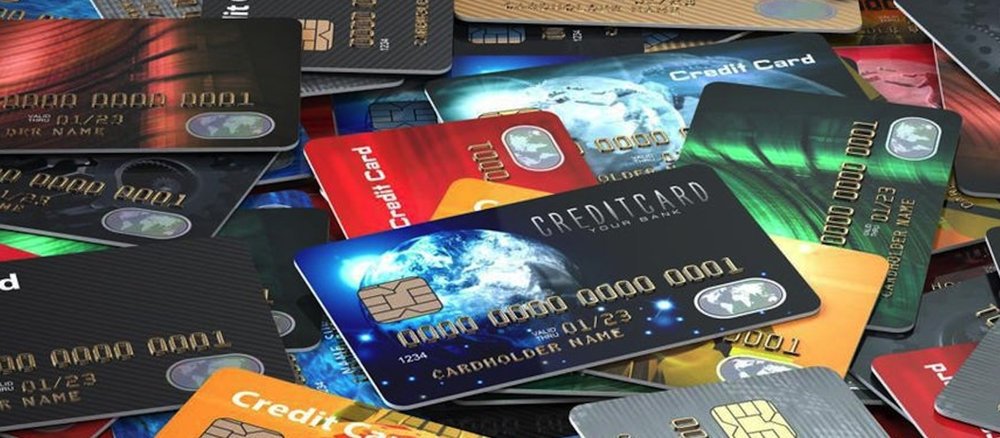

### Context

Credit score cards are a common risk control method in the financial industry. It uses personal information and data submitted by credit card applicants to predict the probability of future defaults and credit card borrowings. The bank is able to decide whether to issue a credit card to the applicant. Credit scores can objectively quantify the magnitude of risk.
 
Generally speaking, credit score cards are based on historical data. Once encountering large economic fluctuations. Past models may lose their original predictive power. Logistic model is a common method for credit scoring. Because Logistic is suitable for binary classification tasks and can calculate the coefficients of each feature. In order to facilitate understanding and operation, the score card will multiply the logistic regression coefficient by a certain value (such as 100) and round it.
 
At present, with the development of machine learning algorithms. More predictive methods such as Boosting, Random Forest, and Support Vector Machines have been introduced into credit card scoring. However, these methods often do not have good transparency. It may be difficult to provide customers and regulators with a reason for rejection or acceptance.

### Problem Statement

We need to identify which customer is eligible for a credit card based on their historical data. Here, we are building a machine learning model to predict if an applicant is 'good' or 'bad' client, different from other tasks, the definition of 'good' or 'bad' is not given.

### Importing Libraries

In [1]:
#Importing necessary libriaries
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

import warnings                        
warnings.filterwarnings('ignore')
import numpy as np      #Linear Algebra 
import pandas as pd     # data processing, CSV file I/O 
import matplotlib.pyplot as plt   # Data visualization libriaries
import seaborn as sns

### Extracting data using two data sources

In [2]:
app_df = pd.read_csv("C:/Users/Dell/Documents/Credit_Card_Prediction/application_record.csv") 
crecord = pd.read_csv("C:/Users/Dell/Documents/Credit_Card_Prediction/credit_record.csv")  

In [3]:
app_df.head()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
1,5008805,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
2,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0
3,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0
4,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0


In [4]:
crecord.head()

,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
1,5001711,-1,0
2,5001711,-2,0
3,5001711,-3,0
4,5001712,0,C


### Data Exploration

* Using different methods to understand data
* data is complex and both dataset need some kind of transformation before analysis
* datasets are indivudally dealt with and then eventually compiled using joins

In [5]:
app_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 438557 entries, 0 to 438556
Data columns (total 18 columns):
ID                     438557 non-null int64
CODE_GENDER            438557 non-null object
FLAG_OWN_CAR           438557 non-null object
FLAG_OWN_REALTY        438557 non-null object
CNT_CHILDREN           438557 non-null int64
AMT_INCOME_TOTAL       438557 non-null float64
NAME_INCOME_TYPE       438557 non-null object
NAME_EDUCATION_TYPE    438557 non-null object
NAME_FAMILY_STATUS     438557 non-null object
NAME_HOUSING_TYPE      438557 non-null object
DAYS_BIRTH             438557 non-null int64
DAYS_EMPLOYED          438557 non-null int64
FLAG_MOBIL             438557 non-null int64
FLAG_WORK_PHONE        438557 non-null int64
FLAG_PHONE             438557 non-null int64
FLAG_EMAIL             438557 non-null int64
OCCUPATION_TYPE        304354 non-null object
CNT_FAM_MEMBERS        438557 non-null float64
dtypes: float64(2), int64(8), object(8)
memory usage: 60.2+ MB


In [6]:
app_df.shape

(438557, 18)

In [7]:
crecord.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 3 columns):
ID                1048575 non-null int64
MONTHS_BALANCE    1048575 non-null int64
STATUS            1048575 non-null object
dtypes: int64(2), object(1)
memory usage: 24.0+ MB


In [8]:
app_df['ID'].nunique() # the total rows are 438,557. This means it has duplicates

438510

In [9]:
crecord['ID'].nunique() 
# this has around 45,000 unique rows as there are repeating entries for different monthly values and status.

45985

In [10]:
# checking to see how many records match in two datasets
len(set(crecord['ID']).intersection(set(app_df['ID']))) 

36457

In [11]:
# Distribution in crecord
crecord['STATUS'].value_counts()

C    442031
0    383120
X    209230
1     11090
5      1693
2       868
3       320
4       223
Name: STATUS, dtype: int64

In [12]:
# categorizing 'STATUS' column to binary classification   0 : Good Client and 1 : bad client
crecord['STATUS'].replace(['C', 'X'],0, inplace=True)

In [13]:
crecord['STATUS'].replace(['2','3','4','5'],1, inplace=True)

In [14]:
crecord['STATUS'] = crecord['STATUS'].astype('int')

In [15]:
crecord['STATUS'].value_counts(normalize=True)*100

0    98.646353
1     1.353647
Name: STATUS, dtype: float64

In [16]:
# transforming crecord 
crecord_trans = crecord.groupby('ID').agg(max).reset_index()
crecord_trans.drop('MONTHS_BALANCE', axis=1, inplace=True)
crecord_trans.head()

,ID,STATUS
0,5001711,0
1,5001712,0
2,5001713,0
3,5001714,0
4,5001715,0


In [17]:
crecord_trans['STATUS'].value_counts(normalize=True)*100

0    88.365771
1    11.634229
Name: STATUS, dtype: float64

## Merging Data sets

In [18]:
# merging the two datasets based on 'ID'
final_df = pd.merge(app_df, crecord_trans, on='ID', how='inner')
final_df.head()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,STATUS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,1
1,5008805,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,1
2,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0,0
3,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0,0
4,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0,0


In [19]:
final_df.shape

(36457, 19)

### Missing Values

In [20]:
final_df.isnull().sum()

ID                         0
CODE_GENDER                0
FLAG_OWN_CAR               0
FLAG_OWN_REALTY            0
CNT_CHILDREN               0
AMT_INCOME_TOTAL           0
NAME_INCOME_TYPE           0
NAME_EDUCATION_TYPE        0
NAME_FAMILY_STATUS         0
NAME_HOUSING_TYPE          0
DAYS_BIRTH                 0
DAYS_EMPLOYED              0
FLAG_MOBIL                 0
FLAG_WORK_PHONE            0
FLAG_PHONE                 0
FLAG_EMAIL                 0
OCCUPATION_TYPE        11323
CNT_FAM_MEMBERS            0
STATUS                     0
dtype: int64

In [21]:
# Removing the null values from the data
final_df = final_df.dropna()
final_df = final_df.reset_index(drop=True)

In [22]:
final_df.shape

(25134, 19)

In [23]:
final_df.head()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,STATUS
0,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0,0
1,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0,0
2,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0,0
3,5008810,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0,0
4,5008811,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0,0


In [24]:
#no duplicates are present
len(final_df['ID']) - len(final_df['ID'].unique())

0

## Features

In [25]:
#Renaming columns for readbility
final_df.rename(columns={'CODE_GENDER':'Gender','FLAG_OWN_CAR':'Car','FLAG_OWN_REALTY':'Reality',
                         'CNT_CHILDREN':'ChldNo','AMT_INCOME_TOTAL':'inc',
                         'NAME_EDUCATION_TYPE':'edutp','NAME_FAMILY_STATUS':'famtp',
                        'NAME_HOUSING_TYPE':'houtp','FLAG_EMAIL':'email',
                         'NAME_INCOME_TYPE':'inctp','FLAG_WORK_PHONE':'wkphone',
                         'FLAG_PHONE':'phone','CNT_FAM_MEMBERS':'famsize',
                        'OCCUPATION_TYPE':'occyp','STATUS':'target'
                        },inplace=True)

In [26]:
# listing categorical(Non-Numerical) Columns
cat_features = final_df.columns[(final_df.dtypes =='object').values].tolist()
cat_features

['Gender', 'Car', 'Reality', 'inctp', 'edutp', 'famtp', 'houtp', 'occyp']

In [27]:
# listing Numerical Columns
num_features = final_df.columns[(final_df.dtypes !='object').values].tolist()
num_features

['ID',
 'ChldNo',
 'inc',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'FLAG_MOBIL',
 'wkphone',
 'phone',
 'email',
 'famsize',
 'target']

In [28]:
# Checking unique values from Categorical Columns

for i in final_df.columns[(final_df.dtypes =='object').values].tolist():
    print(i,'\n')
    print(final_df[i].value_counts())
    print('-----------------------------------------------')

Gender 

F    15630
M     9504
Name: Gender, dtype: int64
-----------------------------------------------
Car 

N    14618
Y    10516
Name: Car, dtype: int64
-----------------------------------------------
Reality 

Y    16461
N     8673
Name: Reality, dtype: int64
-----------------------------------------------
inctp 

Working                 15622
Commercial associate     7052
State servant            2437
Pensioner                  13
Student                    10
Name: inctp, dtype: int64
-----------------------------------------------
edutp 

Secondary / secondary special    16808
Higher education                  7132
Incomplete higher                  993
Lower secondary                    187
Academic degree                     14
Name: edutp, dtype: int64
-----------------------------------------------
famtp 

Married                 17509
Single / not married     3445
Civil marriage           2133
Separated                1467
Widow                     580
Name: famtp, dtype:

In [29]:
# Converting 'DAYS_BIRTH' values from Day to Years
final_df['DAYS_BIRTH'] = round(final_df['DAYS_BIRTH']/-365,0)
final_df.rename(columns={'DAYS_BIRTH':'Age'}, inplace=True)

In [30]:
# Checking unique values greater than 0
final_df[final_df['DAYS_EMPLOYED']>0]['DAYS_EMPLOYED'].unique()
# As mentioned in document, if 'DAYS_EMPLOYED' is non-positive, it means person currently unemployed, hence replacing it with 0
final_df['DAYS_EMPLOYED'].replace(365243, 0, inplace=True)
# Converting 'DAYS_EMPLOYED' values from Day to Years
final_df['DAYS_EMPLOYED'] = abs(round(final_df['DAYS_EMPLOYED']/-365,0))
final_df.rename(columns={'DAYS_EMPLOYED':'worktm'}, inplace=True) 

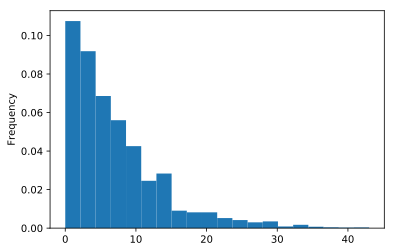

In [31]:
final_df['worktm'].plot(kind='hist',bins=20,density=True)

## Outlier Analysis

#### creating plots to detect outliers

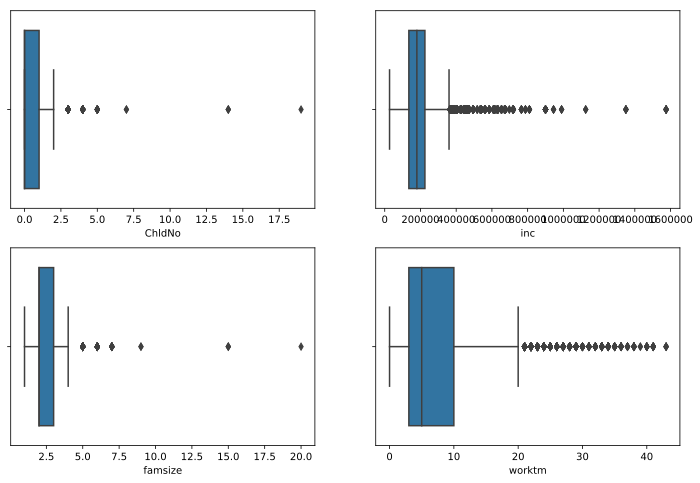

In [32]:
fig, ax= plt.subplots(nrows= 2, ncols = 2, figsize= (12,8))


sns.boxplot(final_df['ChldNo'], ax=ax[0][0])
sns.boxplot(final_df['inc'], ax=ax[0][1])
sns.boxplot(final_df['famsize'], data=final_df, ax=ax[1][0])
sns.boxplot(final_df['worktm'], ax=ax[1][1])

#sns.boxplot(final_df['ChldNo'])

There are outliers in 3 columns.
1. ChldNo
2. inc
3. Famsize
4. YEARS_EMPLOYED


* We need to remove these outliers to make sure they do not affect our model results. 
* We will now remove these outliers. 

In [33]:
# FOR ChldNo COLUMN
q_hi = final_df['ChldNo'].quantile(0.999)
q_low = final_df['ChldNo'].quantile(0.001)
final_df = final_df[(final_df['ChldNo']>=q_low) & (final_df['ChldNo']<=q_hi)]

In [34]:
# FOR inc COLUMN
q_hi = final_df['inc'].quantile(0.999)
q_low = final_df['inc'].quantile(0.001)
final_df = final_df[(final_df['inc']>=q_low) & (final_df['inc']<=q_hi)]

In [35]:
# FOR famsize COLUMN
q_hi = final_df['famsize'].quantile(0.999)
q_low = final_df['famsize'].quantile(0.001)
final_df = final_df[(final_df['famsize']>=q_low) & (final_df['famsize']<=q_hi)]

In [36]:
# FOR worktm COLUMN
q_hi = final_df['worktm'].quantile(0.999)
q_low = final_df['worktm'].quantile(0.001)
final_df = final_df[(final_df['worktm']>=q_low) & (final_df['worktm']<=q_hi)]

In [37]:
final_df.shape

(25043, 19)

## Exploratory Data Analysis

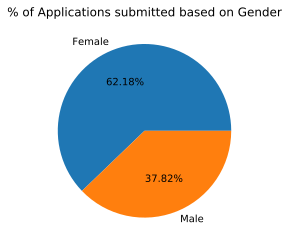

In [38]:
# This graph shows that, majority of application are submitted by Female's
plt.pie(final_df['Gender'].value_counts(), labels=['Female', 'Male'], autopct='%1.2f%%')
plt.title('% of Applications submitted based on Gender')
plt.show()

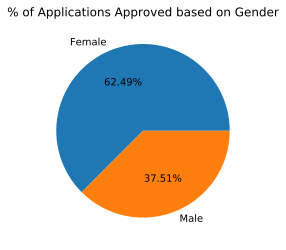

In [39]:
# This graph shows that, majority of application are approved for Female's
plt.pie(final_df[final_df['target']==0]['Gender'].value_counts(), labels=['Female', 'Male'], autopct='%1.2f%%')
plt.title('% of Applications Approved based on Gender')
plt.show()

In [40]:
fig, ax= plt.subplots(nrows= 2, ncols = 2, figsize= (10,6))

sns.scatterplot(x='ID', y='FLAG_MOBIL', data=final_df, ax=ax[0][0])
sns.scatterplot(x='ID', y='wkphone', data=final_df, ax=ax[0][1])
sns.scatterplot(x='ID', y='phone', data=final_df, ax=ax[1][0])
sns.scatterplot(x='ID', y='email', data=final_df, ax=ax[1][1])

In [41]:
# As all the values in FLAG_MOBIL column are 1, hence dropping column
final_df.drop('FLAG_MOBIL', axis=1, inplace=True)

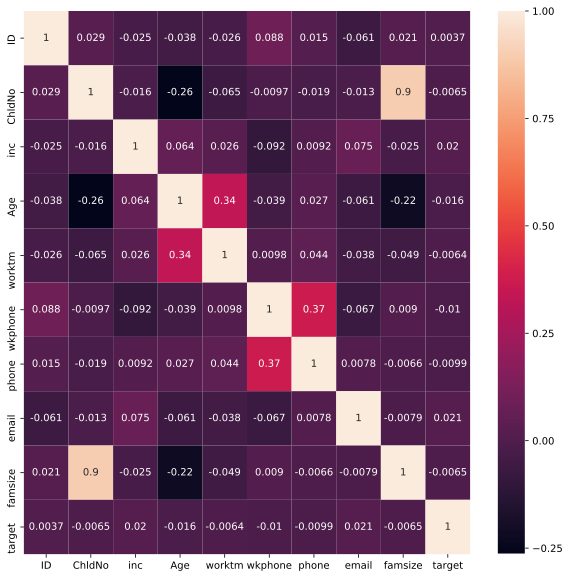

In [42]:
# This graph shows that, there is no column (Feature) which is highly co-related with 'Status'
plt.figure(figsize = (10,10))
sns.heatmap(final_df.corr(), annot=True)
plt.show()

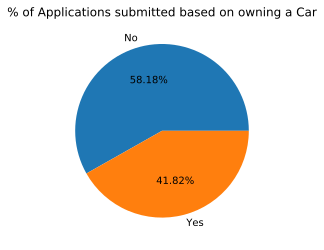

In [43]:
# This graph shows that, majority of applicatant's dont own a car
plt.pie(final_df['Car'].value_counts(), labels=['No', 'Yes'], autopct='%1.2f%%')
plt.title('% of Applications submitted based on owning a Car')
plt.show()

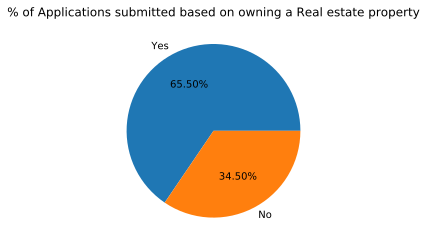

In [44]:
# This graph shows that, majority of applicatant's own a Real Estate property / House
plt.pie(final_df['Reality'].value_counts(), labels=['Yes','No'], autopct='%1.2f%%')
plt.title('% of Applications submitted based on owning a Real estate property')
plt.show()

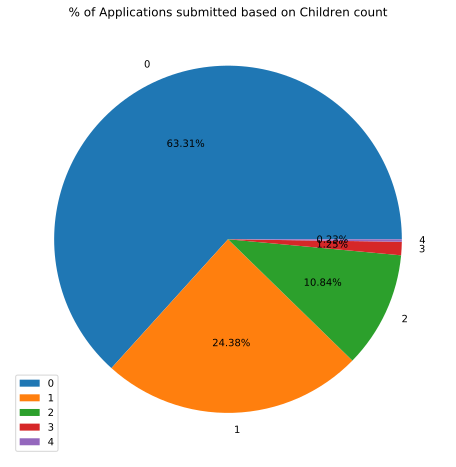

In [45]:
# This graph shows that, majority of applicatant's don't have any children
plt.figure(figsize = (8,8))
plt.pie(final_df['ChldNo'].value_counts(), labels=final_df['ChldNo'].value_counts().index, autopct='%1.2f%%')
plt.title('% of Applications submitted based on Children count')
plt.legend()
plt.show()

In [46]:
final_df['ChldNo'].value_counts()

0    15854
1     6106
2     2714
3      312
4       57
Name: ChldNo, dtype: int64

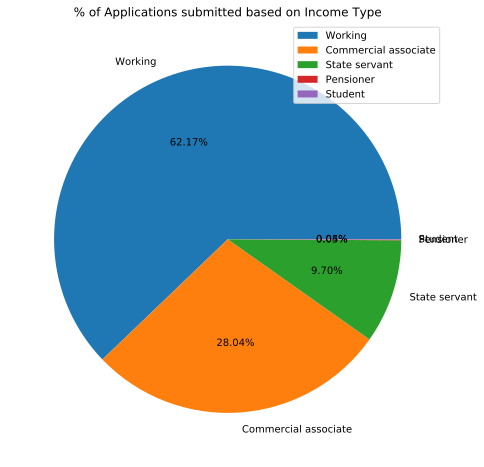

In [47]:
# This graph shows that, majority of applicatant's are working professional
plt.figure(figsize = (8,8))
plt.pie(final_df['inctp'].value_counts(), labels=final_df['inctp'].value_counts().index, autopct='%1.2f%%')
plt.title('% of Applications submitted based on Income Type')
plt.legend()
plt.show()

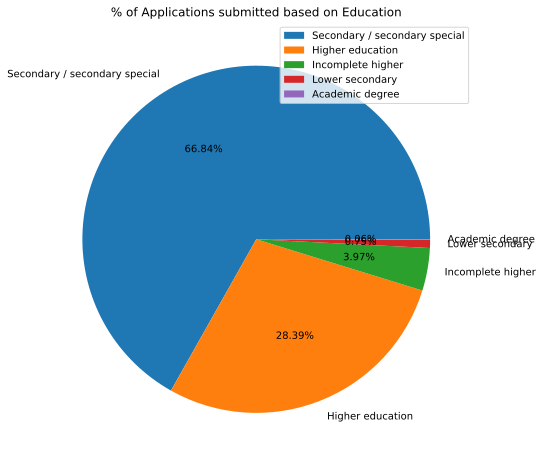

In [48]:
# This graph shows that, majority of applicatant's completed the Secondary Education
plt.figure(figsize=(8,8))
plt.pie(final_df['edutp'].value_counts(), labels=final_df['edutp'].value_counts().index, autopct='%1.2f%%')
plt.title('% of Applications submitted based on Education')
plt.legend()
plt.show()

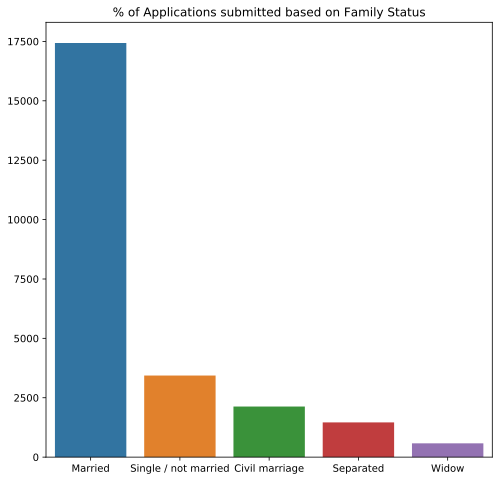

In [49]:
# This graph shows that, majority of applicatant's are married
plt.figure(figsize=(8,8))
sns.barplot(final_df['famtp'].value_counts().index, final_df['famtp'].value_counts().values)
plt.title('% of Applications submitted based on Family Status')
plt.show()

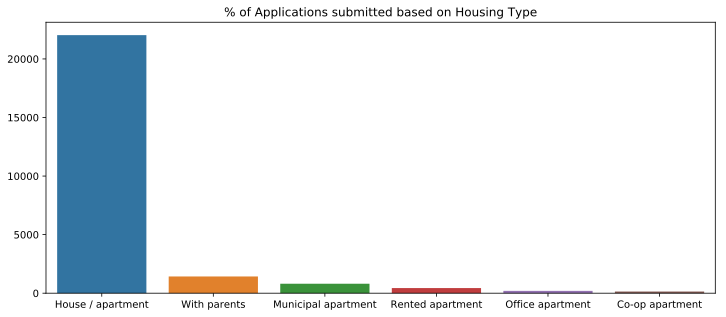

In [50]:
# This graph shows that, majority of applicatant's lives in House / Apartment
plt.figure(figsize=(12,5))
sns.barplot(final_df['houtp'].value_counts().index, final_df['houtp'].value_counts().values)
plt.title('% of Applications submitted based on Housing Type')
plt.show()

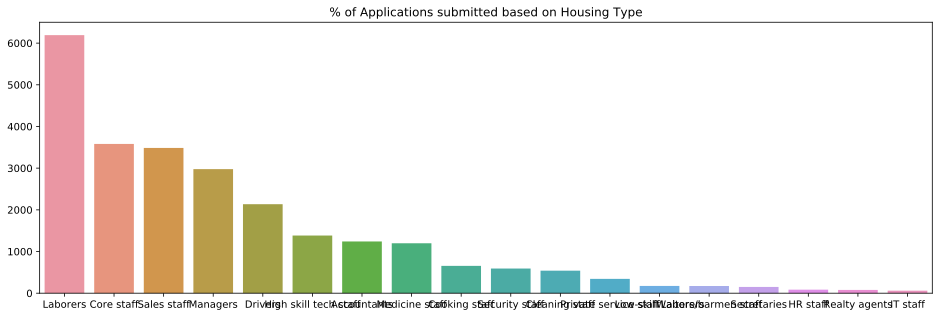

In [51]:
# This graph shows that, majority of applicatant's lives in House / Apartment
plt.figure(figsize=(16,5))
sns.barplot(final_df['occyp'].value_counts().index, final_df['occyp'].value_counts().values)
plt.title('% of Applications submitted based on Housing Type')
plt.show()

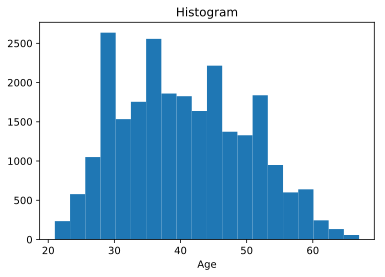

In [52]:
# This graph shows that, majority of applicatant's are 25 to 65 years old
plt.hist(final_df['Age'], bins=20)
plt.xlabel('Age')
plt.title('Histogram')
plt.show()

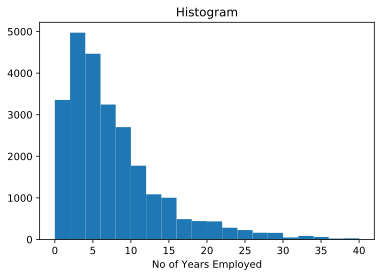

In [53]:
# This graph shows that, majority of applicatant's are Employed for 0 to 7 years
plt.hist(final_df['worktm'], bins=20)
plt.xlabel('No of Years Employed')
plt.title('Histogram')
plt.show()

In [54]:
# This graph shows that, majority of applications are rejected if Total income & years of Employment is less
sns.scatterplot(final_df['worktm'], final_df['inc'], hue=final_df['target'])
plt.title('Scatter Plot')
plt.show()

### Feature Scaling

#### Defining functions for converting dummy and categorizing data 

In [55]:
#convert dummy function is to convert categorical features for modelling 
def convert_dummy(df, feature,rank=0):
    pos = pd.get_dummies(df[feature], prefix=feature)
    mode = df[feature].value_counts().index[rank]
    biggest = feature + '_' + str(mode)
    pos.drop([biggest],axis=1,inplace=True)
    df.drop([feature],axis=1,inplace=True)
    df=df.join(pos)
    return df

In [56]:
#get_category function is to convert continuous variables to categorical
def get_category(df, col, binsnum, labels, qcut = False):
    if qcut:
        localdf = pd.qcut(df[col], q = binsnum, labels = labels) # quantile cut
    else:
        localdf = pd.cut(df[col], bins = binsnum, labels = labels) # equal-length cut
        
    localdf = pd.DataFrame(localdf)
    name = 'gp' + '_' + col
    localdf[name] = localdf[col]
    df = df.join(localdf[name])
    df[name] = df[name].astype(object)
    return df

In [57]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        
    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

#### Gender

In [58]:
final_df['Gender'] = final_df['Gender'].replace(['F','M'],[0,1])
print(final_df['Gender'].value_counts())

0    15571
1     9472
Name: Gender, dtype: int64


#### Having a Car or not

In [59]:
final_df['Car'] = final_df['Car'].replace(['N','Y'],[0,1])
print(final_df['Car'].value_counts())

0    14570
1    10473
Name: Car, dtype: int64


#### Having a house or not

In [60]:
final_df['Reality'] = final_df['Reality'].replace(['N','Y'],[0,1])
print(final_df['Reality'].value_counts())

1    16404
0     8639
Name: Reality, dtype: int64


#### Annual Income

In [61]:
#converting Continous inc to categorical 
final_df = get_category(final_df,'inc', 3, ["low","medium", "high"], qcut = True)

In [62]:
final_df['gp_inc'].value_counts()

low       8968
high      8208
medium    7867
Name: gp_inc, dtype: int64

#### Children

In [63]:
#converting ChldNo to categorical
final_df.loc[final_df['ChldNo'] >= 2,'ChldNo']='2More'
print(final_df['ChldNo'].value_counts(sort=False))

0        15854
1         6106
2More     3083
Name: ChldNo, dtype: int64


#### Age

In [64]:
final_df = get_category(final_df,'Age',5, ["lowest","low","medium","high","highest"])

In [65]:
final_df['gp_Age'].value_counts()

low        7706
medium     7051
high       4715
lowest     4498
highest    1073
Name: gp_Age, dtype: int64

#### Working Years

In [66]:
final_df = get_category(final_df,'worktm',5, ["lowest","low","medium","high","highest"])

In [67]:
final_df['gp_worktm'].value_counts()

lowest     17461
low         5383
medium      1541
high         489
highest      169
Name: gp_worktm, dtype: int64

##### Famliy Size

In [68]:
final_df['famsize'].value_counts(sort=False)

2.0    12636
1.0     4262
3.0     5212
4.0     2575
6.0       51
5.0      307
Name: famsize, dtype: int64

In [69]:
final_df['famsize']=final_df['famsize'].astype(int)
final_df['famsizegp']=final_df['famsize']
final_df['famsizegp']=final_df['famsizegp'].astype(object)
final_df.loc[final_df['famsizegp']>=3,'famsizegp']='3more'

In [70]:
final_df['famsizegp'].value_counts()

2        12636
3more     8145
1         4262
Name: famsizegp, dtype: int64

#### Occupation type

In [71]:
final_df.loc[(final_df['occyp']=='Cleaning staff') | (final_df['occyp']=='Cooking staff') | (final_df['occyp']=='Drivers') | (final_df['occyp']=='Laborers') | (final_df['occyp']=='Low-skill Laborers') | (final_df['occyp']=='Security staff') | (final_df['occyp']=='Waiters/barmen staff'),'occyp']='Laborwk'
final_df.loc[(final_df['occyp']=='Accountants') | (final_df['occyp']=='Core staff') | (final_df['occyp']=='HR staff') | (final_df['occyp']=='Medicine staff') | (final_df['occyp']=='Private service staff') | (final_df['occyp']=='Realty agents') | (final_df['occyp']=='Sales staff') | (final_df['occyp']=='Secretaries'),'occyp']='officewk'
final_df.loc[(final_df['occyp']=='Managers') | (final_df['occyp']=='High skill tech staff') | (final_df['occyp']=='IT staff'),'occyp']='hightecwk'
print(final_df['occyp'].value_counts())

Laborwk      10460
officewk     10164
hightecwk     4419
Name: occyp, dtype: int64


In [72]:
final_df.columns

Index(['ID', 'Gender', 'Car', 'Reality', 'ChldNo', 'inc', 'inctp', 'edutp',
       'famtp', 'houtp', 'Age', 'worktm', 'wkphone', 'phone', 'email', 'occyp',
       'famsize', 'target', 'gp_inc', 'gp_Age', 'gp_worktm', 'famsizegp'],
      dtype='object')

In [73]:
cat_columns = final_df.columns[(final_df.dtypes =='object').values].tolist()
cat_columns

['ChldNo',
 'inctp',
 'edutp',
 'famtp',
 'houtp',
 'occyp',
 'gp_inc',
 'gp_Age',
 'gp_worktm',
 'famsizegp']

In [74]:
#creating dummies for all categorical variables
for col in cat_columns:
    final_df = convert_dummy(final_df,col)
final_df.head()

,ID,Gender,Car,Reality,inc,Age,worktm,wkphone,phone,email,...,gp_Age_high,gp_Age_highest,gp_Age_lowest,gp_Age_medium,gp_worktm_high,gp_worktm_highest,gp_worktm_low,gp_worktm_medium,famsizegp_1,famsizegp_3more
0,5008806,1,1,1,112500.0,59.0,3.0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
1,5008808,0,0,1,270000.0,52.0,8.0,0,1,1,...,1,0,0,0,0,0,0,0,1,0
2,5008809,0,0,1,270000.0,52.0,8.0,0,1,1,...,1,0,0,0,0,0,0,0,1,0
3,5008810,0,0,1,270000.0,52.0,8.0,0,1,1,...,1,0,0,0,0,0,0,0,1,0
4,5008811,0,0,1,270000.0,52.0,8.0,0,1,1,...,1,0,0,0,0,0,0,0,1,0


## Modelling

In [75]:
final_df.columns

Index(['ID', 'Gender', 'Car', 'Reality', 'inc', 'Age', 'worktm', 'wkphone',
       'phone', 'email', 'famsize', 'target', 'ChldNo_1', 'ChldNo_2More',
       'inctp_Commercial associate', 'inctp_Pensioner', 'inctp_State servant',
       'inctp_Student', 'edutp_Academic degree', 'edutp_Higher education',
       'edutp_Incomplete higher', 'edutp_Lower secondary',
       'famtp_Civil marriage', 'famtp_Separated', 'famtp_Single / not married',
       'famtp_Widow', 'houtp_Co-op apartment', 'houtp_Municipal apartment',
       'houtp_Office apartment', 'houtp_Rented apartment',
       'houtp_With parents', 'occyp_hightecwk', 'occyp_officewk',
       'gp_inc_high', 'gp_inc_medium', 'gp_Age_high', 'gp_Age_highest',
       'gp_Age_lowest', 'gp_Age_medium', 'gp_worktm_high', 'gp_worktm_highest',
       'gp_worktm_low', 'gp_worktm_medium', 'famsizegp_1', 'famsizegp_3more'],
      dtype='object')

In [76]:
final_df.shape

(25043, 45)

In [77]:
Y = final_df['target']
X = final_df[[ 'Gender', 'Car', 'Reality', 'ChldNo_1', 'ChldNo_2More',
       'inctp_Commercial associate', 'inctp_Pensioner', 'inctp_State servant',
       'inctp_Student', 'edutp_Academic degree', 'edutp_Higher education',
       'edutp_Incomplete higher', 'edutp_Lower secondary',
       'famtp_Civil marriage', 'famtp_Separated', 'famtp_Single / not married',
       'famtp_Widow', 'houtp_Co-op apartment', 'houtp_Municipal apartment',
       'houtp_Office apartment', 'houtp_Rented apartment',
       'houtp_With parents', 'occyp_hightecwk', 'occyp_officewk',
       'gp_inc_high', 'gp_inc_medium', 'gp_Age_high', 'gp_Age_highest',
       'gp_Age_lowest', 'gp_Age_medium', 'gp_worktm_high', 'gp_worktm_highest',
       'gp_worktm_low', 'gp_worktm_medium']]

In [78]:
X.head()

,Gender,Car,Reality,ChldNo_1,ChldNo_2More,inctp_Commercial associate,inctp_Pensioner,inctp_State servant,inctp_Student,edutp_Academic degree,...,gp_inc_high,gp_inc_medium,gp_Age_high,gp_Age_highest,gp_Age_lowest,gp_Age_medium,gp_worktm_high,gp_worktm_highest,gp_worktm_low,gp_worktm_medium
0,1,1,1,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0
1,0,0,1,0,0,1,0,0,0,0,...,1,0,1,0,0,0,0,0,0,0
2,0,0,1,0,0,1,0,0,0,0,...,1,0,1,0,0,0,0,0,0,0
3,0,0,1,0,0,1,0,0,0,0,...,1,0,1,0,0,0,0,0,0,0
4,0,0,1,0,0,1,0,0,0,0,...,1,0,1,0,0,0,0,0,0,0


In [79]:
Y.value_counts(normalize=True)*100

0    87.729106
1    12.270894
Name: target, dtype: float64

+ Using Synthetic Minority Over-Sampling Technique(`SMOTE`) to overcome sample imbalance problem.

In [80]:
from imblearn.over_sampling import SMOTE
import itertools

Y = Y.astype('int')
X_balance,Y_balance = SMOTE().fit_sample(X,Y)
X_balance = pd.DataFrame(X_balance, columns = X.columns)

+ After over sampling, the number between 1 and 0 is balanced. It can be seen from the confusion matrix.

In [81]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.linear_model import LogisticRegression
import statsmodels.api as sm

In [82]:
X_train, X_test, y_train, y_test = train_test_split(X_balance,Y_balance, 
                                                    stratify=Y_balance,test_size=0.3,
                                                    random_state = 10086)

In [83]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(30758, 34) (13182, 34) (30758,) (13182,)


## Logistic Regression with stats models

$$\log ({p \over {1 - p}}) = {\beta _0} + {\beta _1}{x_1} +  \cdot  \cdot  \cdot  + {\beta _q}{x_q}$$

In [84]:
#fitting the model
logit = sm.Logit(y_train,X_train).fit()
logit.summary()

         Current function value: 0.679596
         Iterations: 35


C:\Users\Dell\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                30758
Model:                          Logit   Df Residuals:                    30724
Method:                           MLE   Df Model:                           33
Date:                Sun, 03 Oct 2021   Pseudo R-squ.:                 0.01955
Time:                        13:03:32   Log-Likelihood:                -20903.
converged:                      False   LL-Null:                       -21320.
                                        LLR p-value:                7.875e-154
==============================================================================================
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Gender                         0.2376      0.028      8.372      0.000       0.182       0.293
Car                           -0.1803      0.026     -7.040      0.000      -0.231      -0.130
Reality                       -0.0600      0.023     -2.634      0.008      -0.105      -0.015
ChldNo_1                      -0.1772      0.029     -6.113      0.000      -0.234      -0.120
ChldNo_2More                  -0.0834      0.037     -2.227      0.026      -0.157      -0.010
inctp_Commercial associate     0.0082      0.027      0.303      0.762      -0.045       0.061
inctp_Pensioner               15.4193    689.290      0.022      0.982   -1335.565    1366.404
inctp_State servant           -0.0922      0.044     -2.110      0.035      -0.178      -0.007
inctp_Student                -22.7795    3.5e+04     -0.001      0.999   -6.86e+04    6.86e+04
edutp_Academic degree          1.3618      0.396      3.440      0.001       0.586       2.138
edutp_Higher education        -0.2912      0.029     -9.963      0.000      -0.349      -0.234
edutp_Incomplete higher       -0.2950      0.066     -4.473      0.000      -0.424      -0.166
edutp_Lower secondary         -0.8694      0.178     -4.891      0.000      -1.218      -0.521
famtp_Civil marriage          -0.2911      0.045     -6.489      0.000      -0.379      -0.203
famtp_Separated               -0.6309      0.060    -10.508      0.000      -0.749      -0.513
famtp_Single / not married    -0.1307      0.036     -3.610      0.000      -0.202      -0.060
famtp_Widow                   -0.4329      0.090     -4.816      0.000      -0.609      -0.257
houtp_Co-op apartment         -1.0530      0.214     -4.919      0.000      -1.473      -0.633
houtp_Municipal apartment     -0.4303      0.077     -5.567      0.000      -0.582      -0.279
houtp_Office apartment        -0.9625      0.175     -5.491      0.000      -1.306      -0.619
houtp_Rented apartment        -0.2822      0.098     -2.873      0.004      -0.475      -0.090
houtp_With parents            -0.2414      0.055     -4.397      0.000      -0.349      -0.134
occyp_hightecwk                0.1779      0.035      5.024      0.000       0.108       0.247
occyp_officewk                 0.2346      0.027      8.575      0.000       0.181       0.288
gp_inc_high                    0.2473      0.030      8.137      0.000       0.188       0.307
gp_inc_medium                  0.0725      0.028      2.579      0.010       0.017       0.128
gp_Age_high                   -0.0303      0.035     -0.871      0.384      -0.098       0.038
gp_Age_highest                -0.0741      0.064     -1.152      0.249      -0.200       0.052
gp_Age_lowest                  0.0797      0.034      2.341      0.019       0.013       0.146
gp_Age_medium                 -0.0433      0.029     -1.514      0.130      -0.099       0.013
gp_worktm_high                -0.4263      0.098     -4.332      0.000      -0.619      -0.233
gp_worktm_h

In [85]:
#predicting the model
logit_predict = logit.predict(X_test)

In [86]:
y_predict=logit_predict.round()

Accuracy Score is 0.56016
      0     1
0  4221  2370
1  3428  3163
[[0.64041875 0.35958125]
 [0.52010317 0.47989683]]


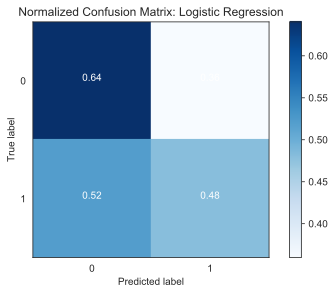

In [87]:
print('Accuracy Score is {:.5}'.format(accuracy_score(y_test, y_predict)))
print(pd.DataFrame(confusion_matrix(y_test,y_predict)))

sns.set_style('white') 
class_names = ['0','1']
plot_confusion_matrix(confusion_matrix(y_test,y_predict),
                      classes= class_names, normalize = True, 
                      title='Normalized Confusion Matrix: Logistic Regression')

### Logistic Regression 

Accuracy Score is 0.59172
      0     1
0  3714  2877
1  2505  4086
[[0.56349568 0.43650432]
 [0.38006372 0.61993628]]


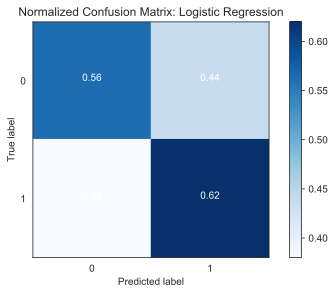

In [88]:
model = LogisticRegression(C=0.8,
                           random_state=0,
                           solver='lbfgs')
model.fit(X_train, y_train)
Y_predict = model.predict(X_test)

print('Accuracy Score is {:.5}'.format(accuracy_score(y_test, Y_predict)))
print(pd.DataFrame(confusion_matrix(y_test,Y_predict)))

sns.set_style('white') 
class_names = ['0','1']
plot_confusion_matrix(confusion_matrix(y_test,Y_predict),
                      classes= class_names, normalize = True, 
                      title='Normalized Confusion Matrix: Logistic Regression')


#### Logistic Regression Metrics

In [89]:
#creating confusion matrix
CM =pd.crosstab(y_test,Y_predict)

In [90]:
#let us save TP, TN, FP, FN
TP = CM.iloc[0,0]
FP = CM.iloc[1,0]
TN = CM.iloc[1,1]
FN = CM.iloc[0,1]

In [91]:
#check recall of the model
recall = ((TP)/(TP+FN))*100
print('Recall score: {} %'.format(recall))
specificity = ((TN)/(TN+FP))*100
print('Specificity: {} %'.format(specificity))
false_positive = ((FP)/(FP+TN))*100
print('False +ve: {} %'.format(false_positive))
false_neg = ((FN)/(FN+TP))*100
print('False -ve: {} %'.format(false_neg))

Recall score: 56.34956759217115 %
Specificity: 61.99362767410105 %
False +ve: 38.00637232589895 %
False -ve: 43.65043240782886 %


In [92]:
#importing metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score

In [93]:
print("Precision score : {} %".format(precision_score(y_test,Y_predict)*100))
print("Recall score : {} %".format(recall_score(y_test,Y_predict)*100))
print("AUC_score is {}%".format(roc_auc_score(y_test,Y_predict)*100))
print("Accuracy is {}%".format(accuracy_score(y_test,Y_predict)*100))

Precision score : 58.68160275743214 %
Recall score : 61.99362767410105 %
AUC_score is 59.171597633136095%
Accuracy is 59.171597633136095%


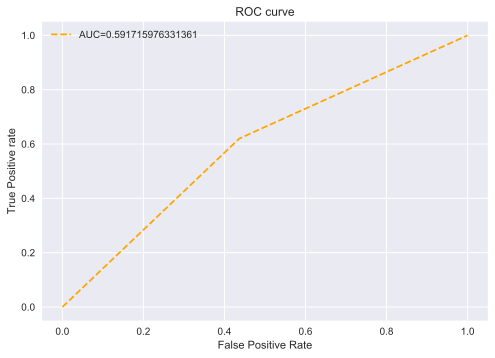

In [94]:
# matplotlib
import matplotlib.pyplot as plt
plt.style.use('seaborn')
from sklearn import metrics



# model = LogisticRegression(C=0.8, random_state=0,solver='lbfgs')
# model.fit(X_train, y_train)
# Y_predict = model.predict(X_test)

#define metrics
#y_pred_proba = log_regression.predict_proba(X_test)[::,1]

fpr, tpr, _ = metrics.roc_curve(y_test,  Y_predict)

auc =  metrics.roc_auc_score(y_test, Y_predict)

# plot roc curves
plt.plot(fpr, tpr, linestyle='--',color='orange', label="AUC="+str(auc))

#plt.plot(fpr2, tpr2, linestyle='--',color='green', label='KNN')
#plt.plot(p_fpr, p_tpr, linestyle='--', color='blue')
# title
plt.title('ROC curve')
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.savefig('ROC',dpi=300)
plt.show()